In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

from PIL import Image
from typing import *

import logging
logging.basicConfig(format='%(asctime)s - %(name)s - %(levelname)s - %(message)s', level=logging.DEBUG)
LOGGER = logging.getLogger(__name__)

## Helper functions

In [2]:
def imshow(img: np.ndarray, scale=1.0):
    temp_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    temp_img = cv2.resize(temp_img, None, fx=scale, fy=scale)
    display(Image.fromarray(temp_img))

def draw_points(img: np.ndarray, points: np.ndarray):
    for x, y in points:
        img = cv2.circle(img, (x,y), radius=5, color=(0, 0, 255), thickness=-1)
    return img

def draw_mask(img: np.ndarray, mask: np.ndarray):
    if len(img.shape) == 3:
        color = (0, 0, 255)
    else:
        color = 255
    temp_img = img.copy()
    temp_img[mask > 0] = color
    return temp_img

In [3]:
class f:
    def __init__(self, func: Callable, *args, **kwargs):
        self.func = func
        self.args = args
        self.kwargs = kwargs

    def __call__(self, img: np.ndarray):
        return self.func(img, *self.args, **self.kwargs)
    
    def __add__(self, o):
        if isinstance(o, f):
            return Pipeline(self, o)
        elif isinstance(o, Pipeline):
            return Pipeline(self, o.func_list)

class Pipeline:
    def __init__(self, *func_list: f):
        self.func_list = func_list
    
    def __call__(self, img: np.ndarray):
        temp_img = img.copy()
        for func in self.func_list:
            temp_img = func(temp_img)
        return temp_img
    
    def __add__(self, o):
        if not isinstance(o, (Pipeline, f)):
            raise TypeError(f"Cannot add '{type(o)}' to Pipeline")
        if isinstance(o, Pipeline):
            return Pipeline(*self.func_list, *o.func_list)
        elif isinstance(o, f):
            return Pipeline(*self.func_list, o)

In [4]:
do_gray = f(cv2.cvtColor, cv2.COLOR_BGR2GRAY)
do_invert = f(cv2.bitwise_not)

final_do_contours = f(cv2.findContours, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

do_otsu = f(lambda img_gray: cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1])

def otsu_canny(img_gray: np.ndarray):
    otsu_thresh, _ = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    edges = cv2.Canny(img_gray, 0.5*otsu_thresh, otsu_thresh, apertureSize=3)
    return edges
do_otsu_canny = f(otsu_canny)


def adaptive_thresh_gauss(img: np.ndarray, blocksize=3, constant=2):
    img_ad_gauss = cv2.adaptiveThreshold(
        img,
        255,
        cv2.ADAPTIVE_THRESH_MEAN_C,
        cv2.THRESH_BINARY_INV,
        blocksize,
        constant,
    )
    return img_ad_gauss
do_adaptive = f(adaptive_thresh_gauss, blocksize=151)

## Histogram equalization (regular & CLAHE) (not useful at all?)

In [49]:
board_img = cv2.imread("./images/indirect_lamp_freeboard.jpg")

In [50]:
def clahe_channels(img: np.ndarray, clipLimit=40, tileGridSize=(5, 5)):
    clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=tileGridSize)
    
    if img.ndim < 3:
        return clahe.apply(img)

    eq_channels = []
    for ch in range(img.shape[-1]):
        eq_channel = clahe.apply(img[..., ch])
        eq_channels.append(eq_channel[..., np.newaxis])
    return np.concatenate(eq_channels, axis=-1)

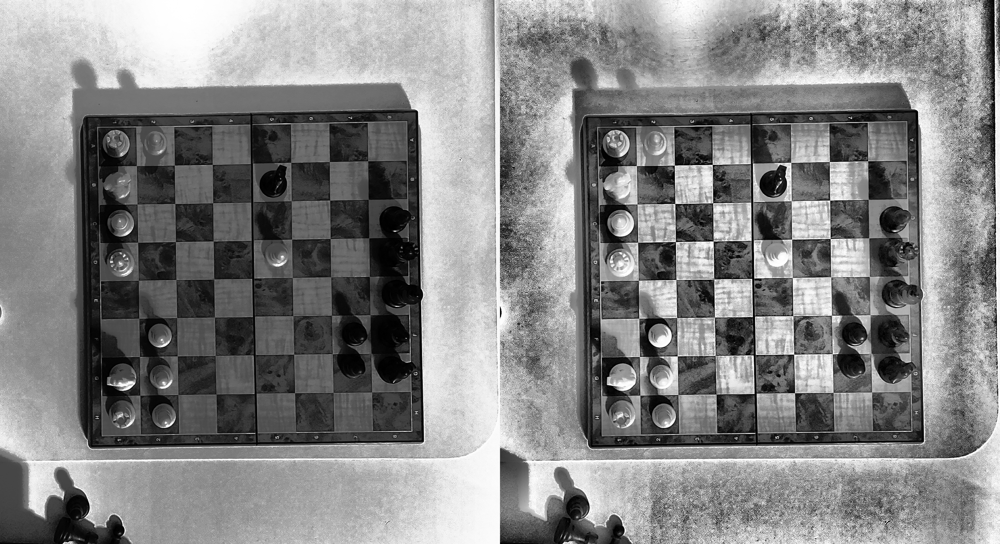

In [51]:
eqhist_img = cv2.equalizeHist(do_gray(board_img))
clahe_img = clahe_channels(do_gray(board_img), clipLimit=200, tileGridSize=(8, 8))
imshow(np.concatenate([eqhist_img, clahe_img], axis=1))

## Corner + Line detection

In [5]:
board_img = cv2.imread("./images/indirect_lamp_freeboard.jpg")

In [6]:
def calc_lines_mask(edges: np.ndarray):
    lines = cv2.HoughLines(edges, 1, np.pi / 180, min(edges.shape) // 5)

    line_mask = np.zeros_like(edges, dtype=np.uint8)
    for rho, theta in lines[:, 0]:
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a * rho
        y0 = b * rho
        x1 = int(x0 + 10000 * (-b))
        y1 = int(y0 + 10000 * (a))
        x2 = int(x0 - 10000 * (-b))
        y2 = int(y0 - 10000 * (a))
        cv2.line(line_mask, (x1, y1), (x2, y2), 255, 2)
    return line_mask
do_lines_mask = f(calc_lines_mask)


def calc_lines_p_mask(edges: np.ndarray):
    lines = cv2.HoughLinesP(edges, 1, np.pi / 180, 100, minLineLength=100, maxLineGap=10)
    
    line_mask = np.zeros_like(edges, dtype=np.uint8)
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(line_mask, (x1, y1), (x2, y2), 255, 2)
    return line_mask
do_lines_p_mask = f(calc_lines_p_mask)

In [7]:
def draw_lines(img: np.ndarray, lines: np.ndarray):
    line_image = np.copy(img)
    if lines is not None:
        for rho, theta in lines[:, 0]:
            a = np.cos(theta)
            b = np.sin(theta)
            x0 = a * rho
            y0 = b * rho
            x1 = int(x0 + 10000 * (-b))
            y1 = int(y0 + 10000 * (a))
            x2 = int(x0 - 10000 * (-b))
            y2 = int(y0 - 10000 * (a))
            cv2.line(line_image, (x1, y1), (x2, y2), (0, 0, 255), 2)
    return line_image

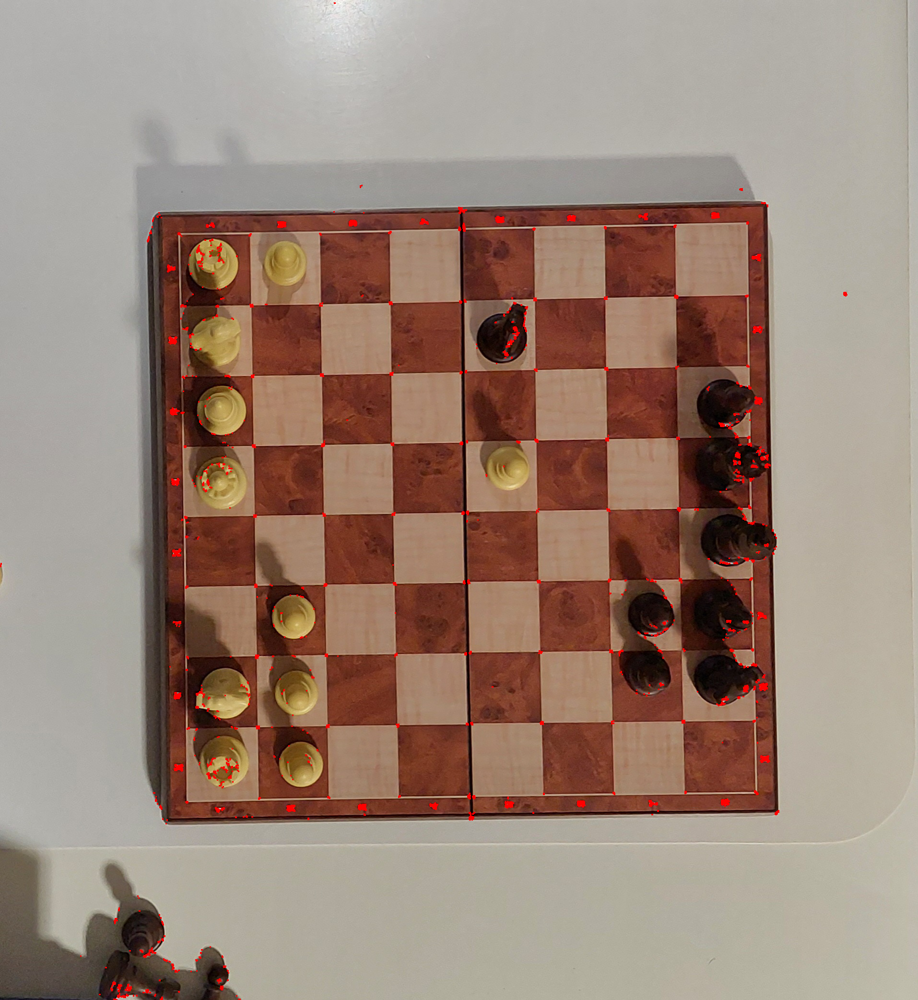

In [8]:
def sobel(src_image, kernel_size: int):
    grad_x = cv2.Sobel(src_image, cv2.CV_16S, 1, 0, ksize=kernel_size, scale=1,
                      delta=0, borderType=cv2.BORDER_DEFAULT)
    grad_y = cv2.Sobel(src_image, cv2.CV_16S, 0, 1, ksize=kernel_size, scale=1, 
                      delta=0, borderType=cv2.BORDER_DEFAULT)
    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)

    grad = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)

    return grad


def calc_corners_mask(img_gray: np.ndarray):
    # img_gray = cv2.GaussianBlur(img_gray, (3, 3), 0)
    img_gray = sobel(img_gray, 3)
    dst = cv2.cornerHarris(img_gray, 2, 3, 0.04)
    dst = cv2.dilate(dst, None)

    corner_mask = np.zeros_like(img_gray, dtype=np.uint8)
    corner_mask[(dst > 0.01*dst.max())] = 255
    return corner_mask



temp_img = board_img.copy()
temp_img[(do_gray + f(calc_corners_mask))(board_img) > 0] = [0, 0, 255]
imshow(temp_img)

In [9]:
line_mask = calc_lines_p_mask(do_gray(board_img))
corner_mask = calc_corners_mask(do_gray(board_img))

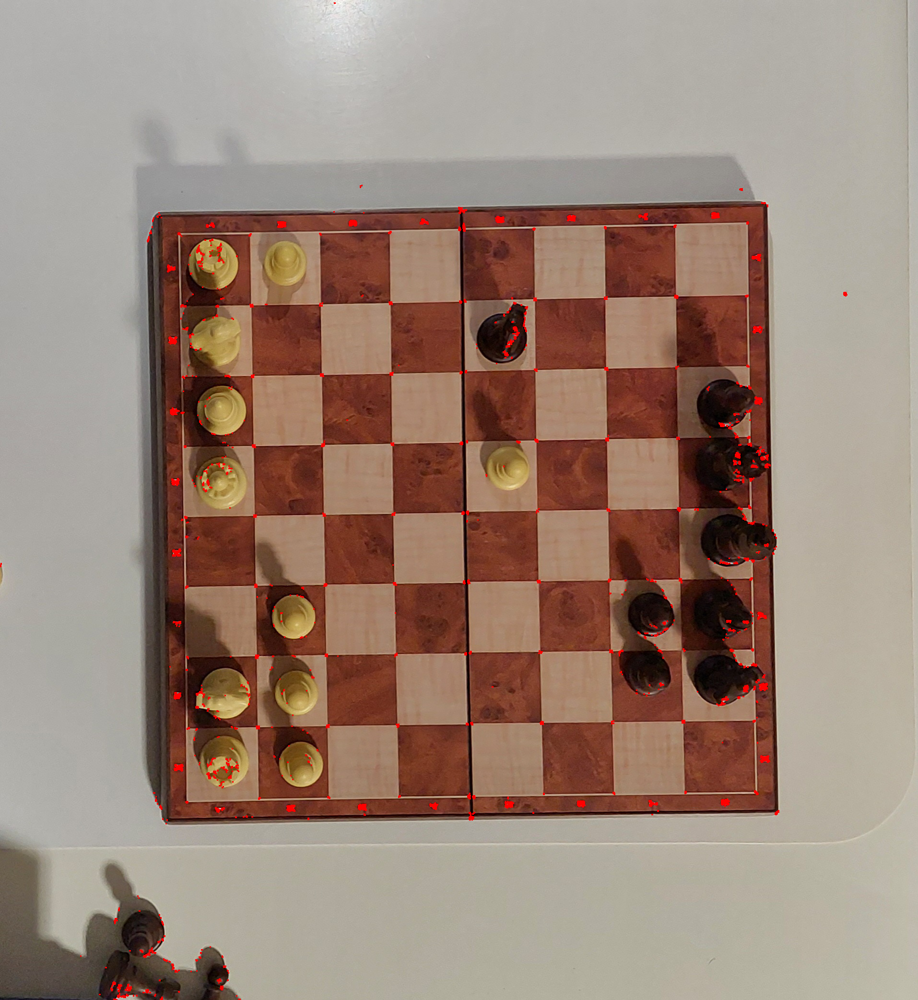

In [10]:
imshow(draw_mask(board_img, cv2.bitwise_and(line_mask, corner_mask)))

## Contours

In [29]:
board_img = cv2.imread("./images/indirect_lamp_freeboard.jpg", cv2.IMREAD_UNCHANGED)
if board_img is not None:
    print("Successfully loaded image")

Successfully loaded image


In [30]:
### THIS DOESN'T WORK
def remove_shadows(img: np.ndarray):
    rgb_planes = cv2.split(img)

    result_planes = []
    result_norm_planes = []
    for plane in rgb_planes:
        dilated_img = cv2.dilate(plane, np.ones((7,7), np.uint8))
        bg_img = cv2.medianBlur(dilated_img, 21)
        diff_img = 255 - cv2.absdiff(plane, bg_img)
        norm_img = cv2.normalize(diff_img,None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8UC1)
        result_planes.append(diff_img)
        result_norm_planes.append(norm_img)
        
    result = cv2.merge(result_planes)
    result_norm = cv2.merge(result_norm_planes)

    return result_norm

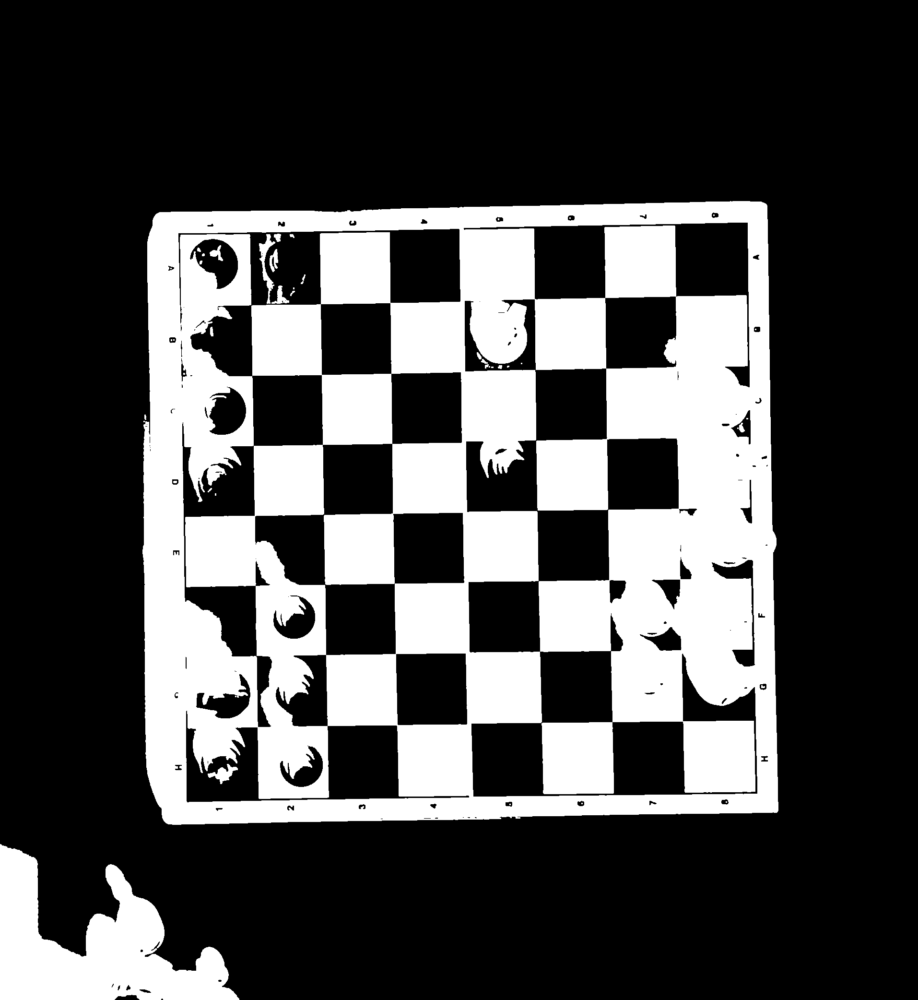

In [31]:
thresh = (
    f(cv2.GaussianBlur, (3,3), 0) + 
    do_gray +
    # f(clahe.apply) + 
    do_otsu + do_invert + 
    f(cv2.morphologyEx, cv2.MORPH_OPEN, np.ones((3,3)), iterations=1)
)(board_img)
imshow(thresh)

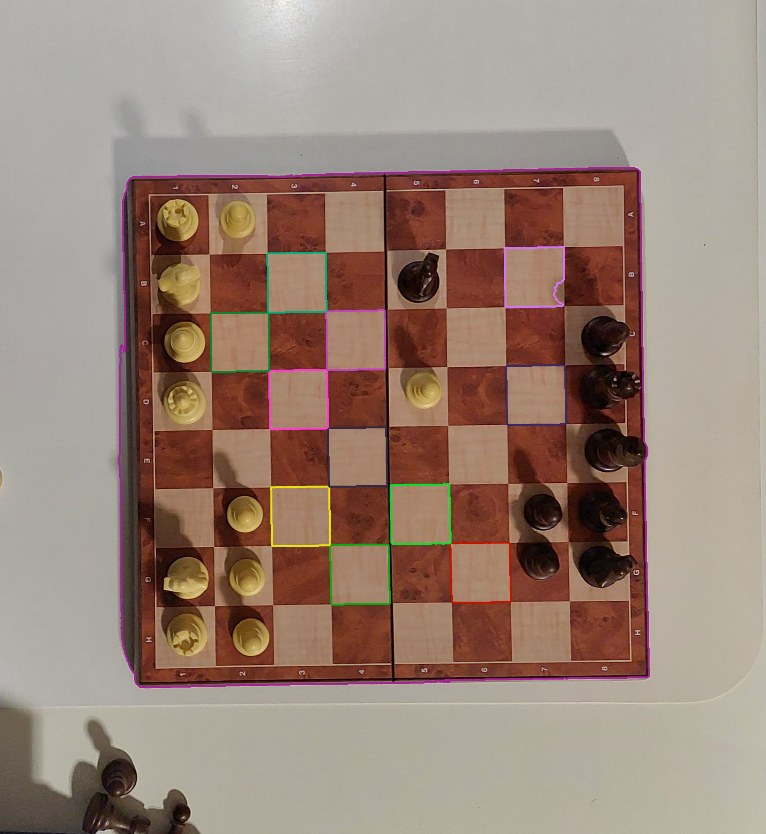

In [32]:
contour_pipe = Pipeline(
    do_gray,
    f(cv2.GaussianBlur, (3, 3), 0),
    do_otsu,
    f(cv2.morphologyEx, cv2.MORPH_OPEN, np.ones((3,3)), iterations=1),
    do_invert,
    f(cv2.findContours, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
)

contours, _ = contour_pipe(board_img)
temp_img = board_img.copy()
sqr_contours = []
areas = []
for contour in contours:
    epsilon = 0.05*cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, epsilon, True)
    area = cv2.contourArea(contour)
    _, _, w, h = cv2.boundingRect(contour)
    if area != 0 and len(approx) == 4 and w*h/area < 1.2 and np.abs(w/h - 1) < 0.2: # Select only sqare contours
        sqr_contours.append(contour)
        areas.append(area)
        cv2.drawContours(temp_img, contour, -1, np.random.randint(255, size=3).tolist(), 3)
sqr_contours = np.array(sqr_contours, dtype=object)
areas = np.array(areas)


imshow(temp_img, 0.4)

In [55]:
### TODO: Idea - if the regular method is too skewed from the whole board center, then calculate squares from the whole board

def calc_fields_centers_from_board_rect(x, y, w, h, border_prop=0.1):
    coeff = 1 - border_prop
    field_w, field_h = coeff*w/8, coeff*h/8
    points = []
    for i in range(8):
        for j in range(8):
            points.append((x+border_prop/2*w + field_w/2 + j*field_w, y+border_prop/2*h + field_h/2 + i*field_h))
    points = np.array(points, dtype=int)
    return points


def get_fields_centers_from_fields(img: np.ndarray):
    contours, _ = contour_pipe(img)

    sqr_contours = []
    areas = []
    for contour in contours:
        epsilon = 0.05*cv2.arcLength(contour, True)
        approx = cv2.approxPolyDP(contour, epsilon, True)
        area = cv2.contourArea(contour)
        _, _, w, h = cv2.boundingRect(contour)
        if area != 0 and len(approx) == 4 and w*h/area < 1.2 and np.abs(w/h - 1) < 0.2: # Select only sqare contours
            sqr_contours.append(contour)
            areas.append(area)
    sqr_contours = np.array(sqr_contours, dtype=object)
    areas = np.array(areas)

    if sqr_contours.size == 0:
        return None

    area_inds_sorted = areas.argsort()
    board_contour = sqr_contours[area_inds_sorted[-1]]
    field_contours = sqr_contours[area_inds_sorted[:-1]] # Get all the squares except the large one (which is the whole board)
    
    if field_contours.size == 0:
        return None

    xs, ys, widths, heights = zip(*[cv2.boundingRect(contour) for contour in field_contours])
    avg_field_w, avg_field_h = np.mean(widths), np.mean(heights)

    left_x, top_y = np.min(xs), np.min(ys) # Top-left coordinates of the top-left field
    right_x = np.max(xs) + widths[np.argmax(xs)]
    bottom_y = np.max(ys) + heights[np.argmax(ys)]
    
    if (np.abs(right_x - left_x - 8*avg_field_w) <= 0.9*avg_field_w) and (np.abs(bottom_y - top_y - 8*avg_field_h) <= 0.9*avg_field_h):
        # The have detected fields next to each board edge, so we can use this
        print("Using fields for centers")
        avg_field_w, avg_field_h = (np.max(xs) - np.min(xs) + avg_field_w) / 8, (np.max(ys) - np.min(ys) + avg_field_h) / 8
        avg_field_w = avg_field_h = np.max([avg_field_w, avg_field_h])
        
        points = []
        for i in range(8):
            for j in range(8):
                points.append((left_x + avg_field_w/2 + j*avg_field_w, top_y + avg_field_h/2 + i*avg_field_h))
        points = np.array(points, dtype=int)
    else:
        # We have to use the outer board contour to determine fields
        print("Using board for centers")
        x, y, w, h = cv2.boundingRect(board_contour)
        border_prop = 0.1
        coeff = 1 - border_prop
        field_w, field_h = coeff*w/8, coeff*h/8
        points = []
        for i in range(8):
            for j in range(8):
                points.append((x+border_prop/2*w + field_w/2 + j*field_w, y+border_prop/2*h + field_h/2 + i*field_h))
        points = np.array(points, dtype=int)

    return points, field_contours, board_contour

Using board for centers


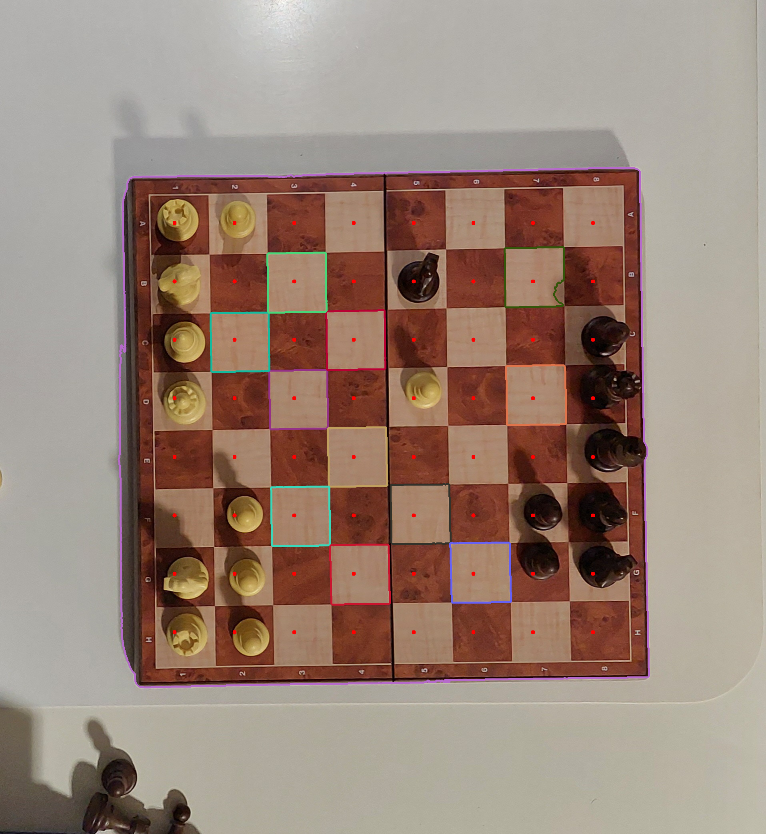

In [56]:
points, field_contours, board_contour = get_fields_centers_from_fields(board_img)

temp_img = board_img.copy()
draw_points(temp_img, points)

for contour in field_contours:
    cv2.drawContours(temp_img, contour, -1, np.random.randint(255, size=3).tolist(), 3)
cv2.drawContours(temp_img, board_contour, -1, np.random.randint(255, size=3).tolist(), 3)

imshow(temp_img, scale=0.4)

## Piece detection (still TODO)

### Hough Circles

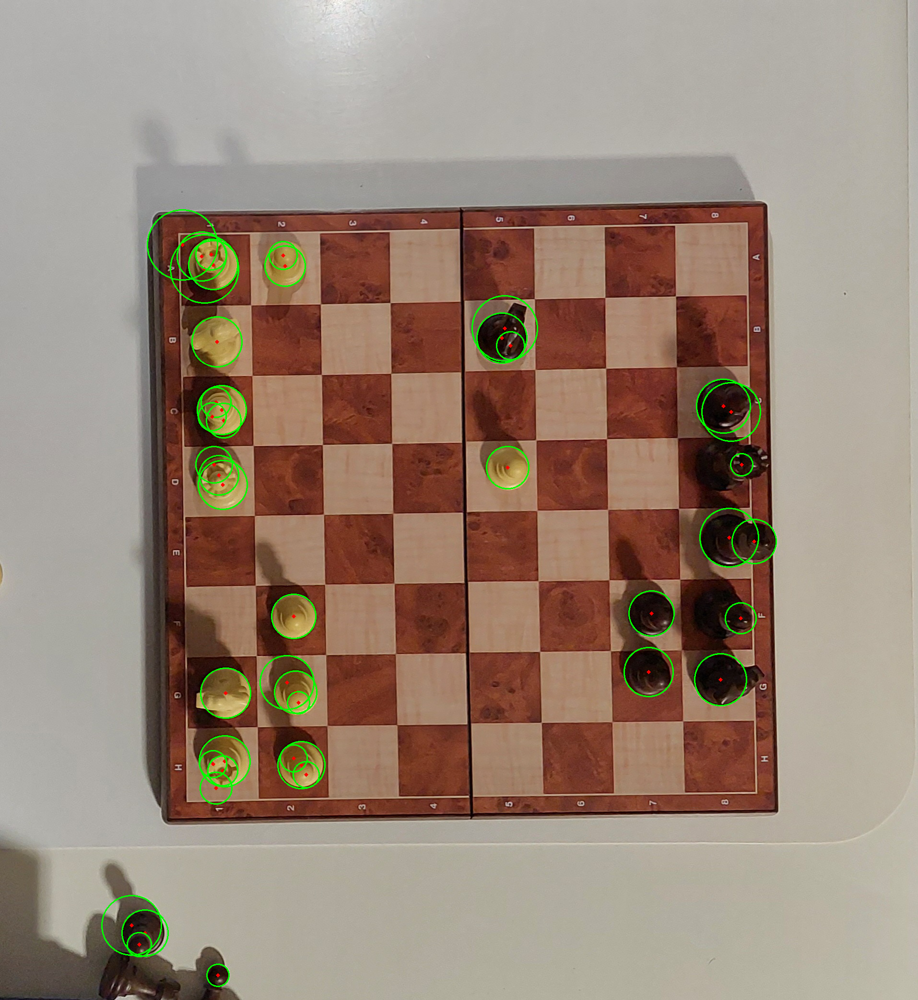

In [57]:
temp_img = board_img.copy()
circles = cv2.HoughCircles((f(cv2.GaussianBlur, (3,3), 0) + do_gray)(board_img),cv2.HOUGH_GRADIENT,1,20,
                            param1=70,param2=35,minRadius=15,maxRadius=75)
circles = np.uint16(np.around(circles))
circles = circles[0]
for i in circles:
    # draw the outer circle
    cv2.circle(temp_img,(i[0],i[1]),i[2],(0,255,0),2)
    # draw the center of the circle
    cv2.circle(temp_img,(i[0],i[1]),2,(0,0,255),3)

imshow(temp_img)

In [58]:
### Merging circles?

x_diff = (circles[:, 0] - circles[:, 0][..., np.newaxis])
y_diff = (circles[:, 1] - circles[:, 1][..., np.newaxis])
radius_sums = (circles[:, 2] + circles[:, 2][..., np.newaxis])

dists = np.sqrt(x_diff**2 + y_diff**2)

merge_mask = dists < radius_sums 

### Template matching

In [59]:
pawn_img = cv2.imread("./images/white_pawn.jpg", cv2.IMREAD_COLOR)
h, w, _ = pawn_img.shape

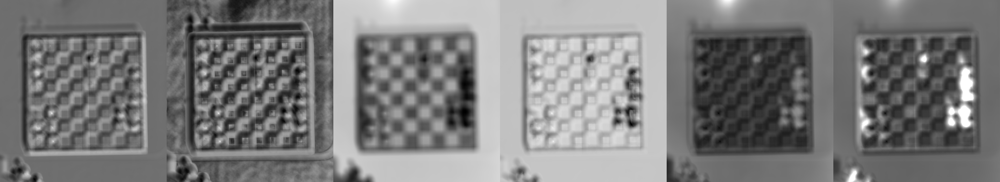

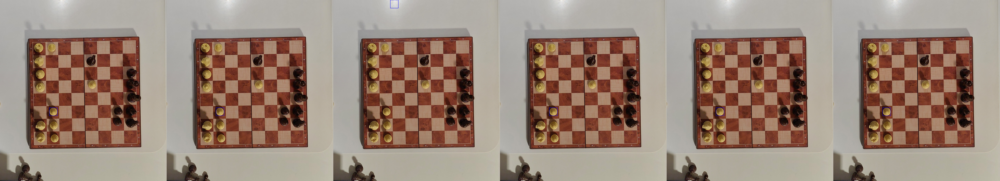

In [60]:
methods = [
    cv2.TM_CCOEFF,
    cv2.TM_CCOEFF_NORMED,
    cv2.TM_CCORR,
    cv2.TM_CCORR_NORMED,
    cv2.TM_SQDIFF,
    cv2.TM_SQDIFF_NORMED,
]
results_rgb = []
results_prob = []
for method in methods:
    _board_img = board_img.copy()
    # Apply template Matching
    res = cv2.matchTemplate(_board_img, pawn_img, method)
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
    # If the method is TM_SQDIFF or TM_SQDIFF_NORMED, take minimum
    if method in [cv2.TM_SQDIFF, cv2.TM_SQDIFF_NORMED]:
        top_left = min_loc
    else:
        top_left = max_loc
    bottom_right = (top_left[0] + w, top_left[1] + h)
    cv2.rectangle(_board_img, top_left, bottom_right, (255, 0, 0), 2)

    results_rgb.append(_board_img)
    results_prob.append(((res - res.min()) * 255 / (res.max() - res.min())).astype(np.uint8))

imshow(np.concatenate(results_prob, 1))
imshow(np.concatenate(results_rgb, 1))

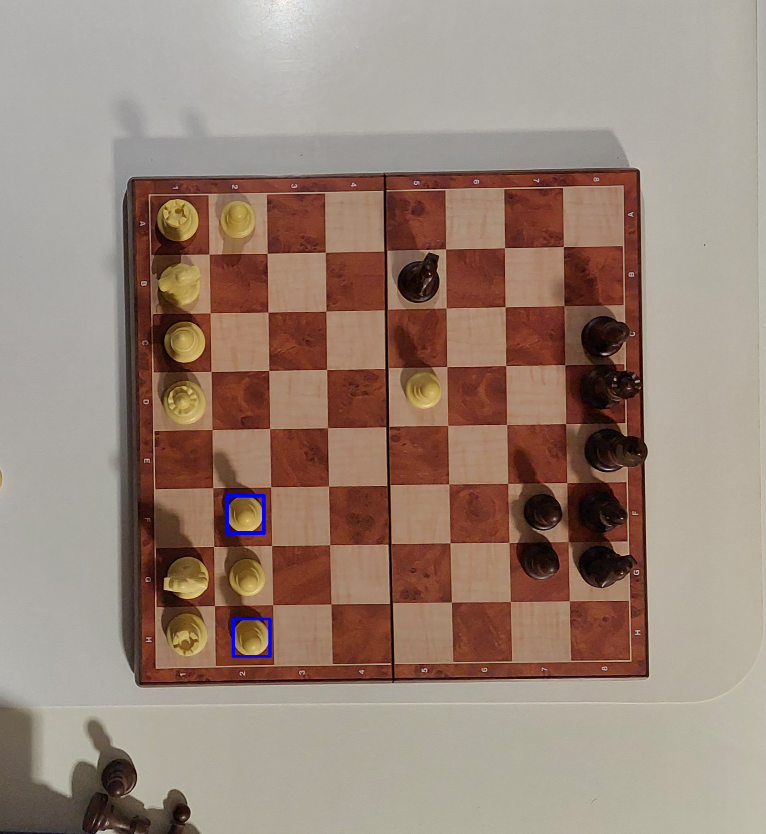

In [61]:
_board_img = board_img.copy()

res = cv2.matchTemplate(_board_img, pawn_img, cv2.TM_CCOEFF_NORMED)
loc = np.where(res >= 0.8)
for pt in zip(*loc[::-1]):
    cv2.rectangle(_board_img, pt, (pt[0] + w, pt[1] + h), (255, 0, 0), 2)

imshow(_board_img, scale=0.4)

## Processing video 

In [62]:
game = cv2.VideoCapture("./videos/Static_cropped.mp4")
if game.isOpened():
    print("Video loaded")
game_fps = game.get(cv2.CAP_PROP_FPS)
game_width, game_height = int(game.get(cv2.CAP_PROP_FRAME_WIDTH)), int(game.get(cv2.CAP_PROP_FRAME_HEIGHT))

Video loaded


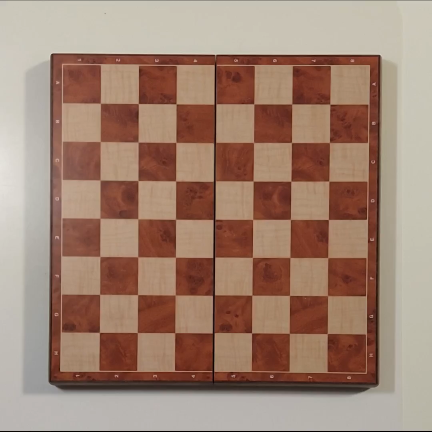

In [63]:
game.set(cv2.CAP_PROP_POS_FRAMES, 150)
ret, test_frame = game.read()
test_frame_gray = cv2.cvtColor(test_frame, cv2.COLOR_BGR2GRAY)
imshow(test_frame, scale=0.4)

In [64]:
game_centers = cv2.VideoWriter(
    "./videos/Static_centers.avi",
    cv2.VideoWriter_fourcc(*"MJPG"),
    game_fps,
    (game_width, game_height)
)

game.set(cv2.CAP_PROP_POS_FRAMES, 0)
i = 0
while game.isOpened():
    ret, frame = game.read()

    if ret:
        if i%25 == 0:
            center_results = get_fields_centers_from_fields(frame)
            if center_results is not None:
                points, field_contours, board_contour = center_results

        temp_frame = frame.copy()
        draw_points(temp_frame, points)
        game_centers.write(temp_frame)

        i += 1
    else:
        break

game_centers.release()

Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using board for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using board for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Using fields for centers
Us

## cv2.findChessboardCorners() - [MAYBE ON TOP-DOWN EMPTY BOARD ONLY]

In [264]:
ret, corners = cv2.findChessboardCorners(
    do_gray(board_img), 
    (7, 7), 
    None, 
    flags=cv2.CALIB_CB_ADAPTIVE_THRESH+ cv2.CALIB_CB_EXHAUSTIVE
)
ret
if ret:
    imshow(draw_points(board_img, corners[:, 0, :].astype(np.int32)))
else:
    print("Could not find the chessboard")

Could not find the chessboard
